![OPI Analytics Logo](opi-analytics.png)
### Examen Data Science - Nivel intermedio
#### Presenta - Daniel Xoconostle

                                                    Sección A

#### A.2 Datos abiertos de la CDMX
    La Agencia Digital de Innovación Pública tiene disponibles los datos georeferenciados de las carpetas de 
    investigación aportados por la PGJ. La tabla está disponible aquí:
    https://datos.cdmx.gob.mx/explore

    1) ¿Qué pruebas identificarías para asegurar la calidad de estos datos? No es necesario hacerlas. Sólo describe la prueba y qué te dice cada una.

In [1]:
# DataFrame.sample(7) #Para conocer cómo están estructurados mis datos
# DataFrame.dtypes #Para saber si los tipos de datos coinciden con la información mostrada en cada columna
# DataFrame.isnull().sum()/df_pgj.shape[0] *100 #Para obtener el porcentaje de cuántas celdas están vacias por cada columna
# DataFrame.describe() #Muestra valores estadísticos en los campos numéricos
# DataFrame.corr() #Es posible que se pueda retirar información si la correlación es alta ente columnas

    2) ¿Cuántos delitos registrados hay en la tabla? ¿Qué rango de tiempo consideran los datos?

In [2]:
# importar las librerías necesarias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re

In [3]:
# se importa la información
df_pgj = pd.read_csv('carpetas-pgj.csv')

In [4]:
# primero se revisan las columnas que hay en el dataframe
print(df_pgj.columns)
# los tipos de datos que tiene el dataframe
print("\n",df_pgj.dtypes)
# y una muestra para ver la forma de los datos
df_pgj.sample(5)

Index(['ao_hechos', 'mes_hechos', 'fecha_hechos', 'delito', 'categoria_delito',
       'fiscalia', 'agencia', 'unidad_investigacion', 'alcaldia_hechos',
       'colonia_hechos', 'ao_inicio', 'mes_inicio', 'fecha_inicio',
       'calle_hechos', 'calle_hechos2', 'longitud', 'latitud', 'geopoint'],
      dtype='object')

 ao_hechos               float64
mes_hechos               object
fecha_hechos             object
delito                   object
categoria_delito         object
fiscalia                 object
agencia                  object
unidad_investigacion     object
alcaldia_hechos          object
colonia_hechos           object
ao_inicio                 int64
mes_inicio               object
fecha_inicio             object
calle_hechos             object
calle_hechos2            object
longitud                float64
latitud                 float64
geopoint                 object
dtype: object


,ao_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalia,agencia,unidad_investigacion,alcaldia_hechos,colonia_hechos,ao_inicio,mes_inicio,fecha_inicio,calle_hechos,calle_hechos2,longitud,latitud,geopoint
718468,2017.0,Marzo,2017-03-15 04:30:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,URI-CUH-2,UI-1SD,CUAUHTEMOC,BUENAVISTA,2017,Marzo,2017-03-16 18:43:18,EJE 1 NTE. MOSQUETA,NaN,-99.151449,19.446017,"19.4460172795,-99.1514493317"
702189,2017.0,Julio,2017-07-07 07:50:00,ROBO A TRANSEUNTE DE CELULAR SIN VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN ÁLVARO OBREGÓN,AO-1,UI-1SD,ALVARO OBREGON,SANTA LUCIA,2017,Julio,2017-07-07 10:26:22,AVENIDA TAMAULIPAS 100,NaN,-99.258086,19.356978,"19.3569780169,-99.2580857655"
82596,2020.0,Febrero,2020-02-15 12:00:00,ROBO DE ALHAJAS,DELITO DE BAJO IMPACTO,FISCALÍA DE INVESTIGACIÓN TERRITORIAL EN MILPA...,MIL-2,UI-1SD,MILPA ALTA,XALTIPAC (SAN ANTONIO TECOMITL),2020,Marzo,2020-03-14 11:14:16,NICOLAS BRAVO,NaN,-98.991927,19.220768,"19.2207681658,-98.9919270195"
952497,2019.0,Enero,31/01/2019 04:40,ROBO A NEGOCIO SIN VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN GUSTAVO A. MADERO,GAM-8,UI-1SD,GUSTAVO A MADERO,CUCHILLA LA JOYA,2019,Enero,31/01/2019 14:08,ORIENTE 91,NaN,-99.110280,19.460500,"19.4605,-99.11028"
620184,2019.0,Febrero,18/02/2019 15:30:00,VIOLENCIA FAMILIAR,DELITO DE BAJO IMPACTO,JUZGADOS FAMILIARES,75BIS,3 S/D,CUAUHTEMOC,JUÁREZ,2019,Febrero,19/02/2019 13:40:16,AVENIDA REFORMA,AVENIDA SEVILLA,-99.171410,19.424660,"19.42466,-99.17141"


In [5]:
# esta celda se añade después de haber procesado la mayoría de los datos.
# se vuelve evidente que hay información en la base de datos que no pertenece a la CDMX
# por lo cual se depura la base
# datos obtenidos de https://www.cdmxpolitico.com/p/alcaldias.html
alcaldias_oficiales = ["ALVARO OBREGON","AZCAPOTZALCO","BENITO JUAREZ","COYOACAN","CUAJIMALPA","CUAUHTEMOC",
                       "GUSTAVO A MADERO","IZTACALCO","IZTAPALAPA","MAGDALENA CONTRERAS","MIGUEL HIDALGO",
                       "MILPA ALTA","TLAHUAC","TLALPAN","VENUSTIANO CARRANZA","XOCHIMILCO"]


In [6]:
 df_pgj = df_pgj.loc[df_pgj["alcaldia_hechos"].isin(alcaldias_oficiales)]

In [7]:
# aplicar "len" y "unique" para obtener la información
print(f"La tabla muestra una cantidad total de {len(df_pgj.delito)} delitos con {len(df_pgj.delito.unique())} tipos únicos.")

La tabla muestra una cantidad total de 1037667 delitos con 369 tipos únicos.


In [8]:
print("La base de datos comprende delitos desde {} y hasta {}.".format(int(df_pgj.ao_hechos.min()),int(df_pgj.ao_hechos.max())))

La base de datos comprende delitos desde 1906 y hasta 2020.


    3) ¿Cómo se distribuye el número de delitos en la CDMX? ¿Cuáles son los 5 delitos más frecuentes?

In [9]:
# primer se intenta responder la pregunta directamente, pero no hay una columna que cuente la información de manera clara
# por lo tanto se añade una columna llamada "contador" que contiene "1",
# de esta manera se obtiene una columna que puede servir para contar los datos de cualquier otra columna
df_pgj["contador"]=1
# se aplica "groupby" que nos permite agrupar las filas del dataframe por cada valor único en la columna "delito"
# después de agruparlos, se extraen solamente los datos de la columna "contador" a una serie llamada "top_5"
top_5 = df_pgj.groupby("delito").count()["contador"]
# se ordena la serue en forma descendente, donde el nombre del delito sirve como índice
top_5.sort_values(ascending=False)[:5]

delito
VIOLENCIA FAMILIAR                                97053
ROBO A NEGOCIO SIN VIOLENCIA                      63045
ROBO DE OBJETOS                                   62962
FRAUDE                                            61024
ROBO A TRANSEUNTE EN VIA PUBLICA CON VIOLENCIA    54226
Name: contador, dtype: int64

    4) Identifica los delitos que van a la alza y a la baja en la CDMX en el último año (ten cuidado con los delitos con pocas ocurrencias).

In [10]:
# se elige "mayor a 2018" y "menor a 2020" para obtener solamente los datos de 2019
# se incorpora sólo la suficiente información para responder la pregunta a un dataframe nuevo
delitos_ab = df_pgj[(df_pgj["ao_hechos"]>2018)&(df_pgj["ao_hechos"]<2020)][["mes_hechos","delito","contador"]]
delitos_ab.reset_index(inplace=True)
# al resetar el index, los datos anteriores se guardan en una nueva columna que descartamos
delitos_ab.drop('index',axis=1,inplace=True)

In [11]:
# comparar enero con diciembre, si diciembre es mayor entonces guardar el tipo de delito en lista crimenes_alza
# guardar delito en crimenes_baja si enero es mayor a diciembre
# para evitar los delitos con pocas incidencias, se guardan solamente aquellos donde la diferencia es mayor a 50
crimenes = df_pgj.delito.unique()
crimenes_alza = []
crimenes_baja = []
for i in range(len(crimenes)):
    a = delitos_ab[(delitos_ab.delito==crimenes[i])&(delitos_ab.mes_hechos=="Enero")]["contador"].count()
    b = delitos_ab[(delitos_ab.delito==crimenes[i])&(delitos_ab.mes_hechos=="Diciembre")]["contador"].count()
    if (b-a)>50:
        crimenes_alza.append([crimenes[i],b-a])
    elif (a-b)>50:
        crimenes_baja.append([crimenes[i],a-b])

In [12]:
crimenes_alza

[['AMENAZAS', 154],
 ['VIOLENCIA FAMILIAR', 410],
 ['DAÑO EN PROPIEDAD AJENA CULPOSA POR TRÁNSITO VEHICULAR A AUTOMOVIL', 75],
 ['TENTATIVA DE EXTORSION', 83],
 ['PRODUCCIÃ“N, IMPRESIÃ“N, ENAJENACIÃ“N, DISTRIBUCIÃ“N, ALTERACIÃ“N O FALSIFICACIÃ“N DE TÃ\x8dTULOS AL PORTADOR, DOCUMENTOS DE CRÃ‰DITO PÃšBLICOS O VALES DE CANJE',
  74]]

In [13]:
crimenes_baja

[['ROBO A CASA HABITACION SIN VIOLENCIA', 53],
 ['DENUNCIA DE HECHOS', 149],
 ['ROBO DE OBJETOS', 170],
 ['ROBO A REPARTIDOR CON VIOLENCIA', 73],
 ['ROBO A TRANSEUNTE EN VIA PUBLICA CON VIOLENCIA', 208],
 ['USURPACIÓN DE IDENTIDAD', 202],
 ['ROBO DE ACCESORIOS DE AUTO', 206],
 ['ROBO A NEGOCIO SIN VIOLENCIA', 206],
 ['ROBO DE VEHICULO DE SERVICIO PARTICULAR SIN VIOLENCIA', 144],
 ['FRAUDE', 143],
 ['ROBO A NEGOCIO CON VIOLENCIA', 269],
 ['ROBO DE VEHICULO DE PEDALES', 60],
 ['ROBO A PASAJERO A BORDO DE PESERO COLECTIVO CON VIOLENCIA', 78],
 ['EXTORSION', 51],
 ['ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA', 507],
 ['ROBO A PASAJERO / CONDUCTOR DE VEHICULO CON VIOLENCIA', 83],
 ['ROBO A TRANSEUNTE DE CELULAR SIN VIOLENCIA', 144],
 ['ROBO A PASAJERO A BORDO DE TRANSPORTE PÚBLICO CON VIOLENCIA', 74],
 ['ROBO A PASAJERO A BORDO DE METRO SIN VIOLENCIA', 195],
 ['PRODUCCIÓN, IMPRESIÓN, ENAJENACIÓN, DISTRIBUCIÓN, ALTERACIÓN O FALSIFICACIÓN DE TÍTULOS AL PORTADOR, DOCUMENTOS DE CRÉDITO PÚBLICOS

    5) ¿Cuál es la alcaldía que más delitos tiene y cuál es la que menos?.¿Por qué crees que sea esto?

In [14]:
delitos_alcaldia = df_pgj.groupby("alcaldia_hechos").count()["contador"]
# se ordena la serie en forma descendente, donde el nombre del delito sirve como índice
print(f"""mayor número de delitos:\n{delitos_alcaldia.sort_values(ascending=False)[:1]}

menor número de delitos:
{delitos_alcaldia.sort_values(ascending=False)[-1:]}\n
En la delegación Cuauhtemoc se concentran la generación de recursos que permanecen en la misma delegación,
junto con varias zonas acomodadas de la CDMX, además de que está rodeada en 3 direcciones por el circuito
interior y la atraviesa la av. insurgentes.
La delegación Milpa Alta, en cambio, se localiza al sur de la CDMX en una zona con menos facilidades de
transportación y cuya población se desplaza a otras partes para trabajar.""")

mayor número de delitos:
alcaldia_hechos
CUAUHTEMOC    170940
Name: contador, dtype: int64

menor número de delitos:
alcaldia_hechos
MILPA ALTA    7261
Name: contador, dtype: int64

En la delegación Cuauhtemoc se concentran la generación de recursos que permanecen en la misma delegación,
junto con varias zonas acomodadas de la CDMX, además de que está rodeada en 3 direcciones por el circuito
interior y la atraviesa la av. insurgentes.
La delegación Milpa Alta, en cambio, se localiza al sur de la CDMX en una zona con menos facilidades de
transportación y cuya población se desplaza a otras partes para trabajar.


    6) Dentro de cada alcaldía, cuáles son las tres colonias con más delitos

In [15]:
top3_cols = df_pgj.groupby(["alcaldia_hechos","colonia_hechos"]).agg({'contador':sum})
g = top3_cols["contador"].groupby(level=0, group_keys=False)
res = g.apply(lambda x: x.sort_values(ascending=False).head(3))
res

alcaldia_hechos      colonia_hechos                  
ALVARO OBREGON       JARDINES DEL PEDREGAL                3276
                     SAN ANGEL                            2630
                     ZEDEC SANTA FE                       2504
AZCAPOTZALCO         EL ROSARIO                           3740
                     INDUSTRIAL VALLEJO                   2466
                     CENTRO DE AZCAPOTZALCO               2280
BENITO JUAREZ        DEL VALLE CENTRO                    16129
                     NARVARTE                            11769
                     PORTALES SUR                         5977
COYOACAN             PEDREGAL DE SANTO DOMINGO            6192
                     AJUSCO                               3336
                     PEDREGAL DE SANTA URSULA             3260
CUAUHTEMOC           CENTRO                              36526
                     DOCTORES                            21319
                     ROMA NORTE                          13262
G

    7) ¿Existe alguna tendencia estacional en la ocurrencia de delitos (mes, semana, día de la semana, quincenas)?

In [16]:
meses = df_pgj.groupby(["mes_hechos"]).count()["contador"]
mes_list = ["Enero","Febrero","Marzo","Abril","Mayo","Junio",
            "Julio","Agosto","Septiembre","Octubre","Noviembre","Diciembre"]

# loop para ordenar los meses de acuerdo a calendario

orden = []
for m in range(len(meses)):
    for n in range(len(mes_list)):
        if meses.keys()[m] == mes_list[n]:
            orden.append([mes_list[m],meses[n]])

ord_df = pd.DataFrame(orden,columns=["meses","n_delitos"])

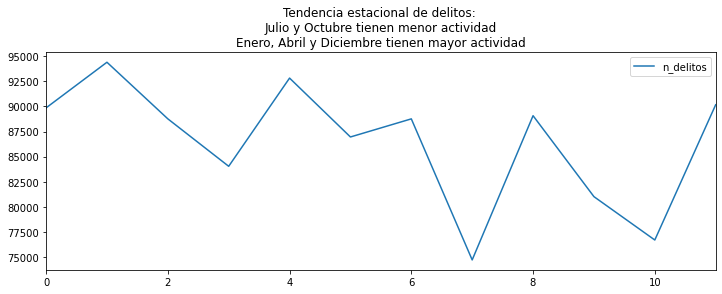

In [17]:
ord_df.plot(figsize=(12,4))
plt.title("Tendencia estacional de delitos: \nJulio y Octubre tienen menor actividad\nEnero, Abril y Diciembre tienen mayor actividad")
plt.show()

    8) ¿Cuales son los delitos que más caracterizan a cada alcaldía? Es decir, delitos que suceden con mayor frecuencia en una alcaldía y con menor frecuencia en las demás.

In [18]:
top3_cols = df_pgj.groupby(["alcaldia_hechos","delito"]).agg({'contador':sum})
g = top3_cols["contador"].groupby(level=1, group_keys=False)
res = g.apply(lambda x: x.sort_values(ascending=False)[:1])
res

alcaldia_hechos  delito                                              
CUAUHTEMOC       ABANDONO DE PERSONA                                       652
IZTAPALAPA       ABORTO                                                    101
CUAUHTEMOC       ABUSO DE AUTORIDAD                                       1291
IZTAPALAPA       ABUSO DE AUTORIDAD Y USO ILEGAL DE LA FUERZA PUBLICA      827
CUAUHTEMOC       ABUSO DE CONFIANZA                                       2879
                                                                         ...  
                 VIOLACION TUMULTUARIA                                      27
                 VIOLACION TUMULTUARIA EQUIPARADA                            1
XOCHIMILCO       VIOLACION TUMULTUARIA EQUIPARADA POR CONOCIDO               1
ALVARO OBREGON   VIOLACION Y ROBO DE VEHICULO                                1
IZTAPALAPA       VIOLENCIA FAMILIAR                                      19078
Name: contador, Length: 369, dtype: int64

    9) Calcula el número de homicidios dolosos por cada 100 mil habitantes anual para cada Área Geoestadística Básica (AGEB) del INEGI. (hint: no importa que el dato de población no esté actualizado).
        a) Pinta un mapa con este indicador. Describe los resultados.

In [19]:
temp4 = df_pgj[df_pgj.categoria_delito=="HOMICIDIO DOLOSO"]
temp5 = temp4.groupby("alcaldia_hechos").count()
temp5[temp5.contador>50]["contador"]/100000

alcaldia_hechos
ALVARO OBREGON         0.00441
AZCAPOTZALCO           0.00218
BENITO JUAREZ          0.00110
COYOACAN               0.00216
CUAUHTEMOC             0.00558
GUSTAVO A MADERO       0.00986
IZTACALCO              0.00212
IZTAPALAPA             0.01328
MIGUEL HIDALGO         0.00234
MILPA ALTA             0.00067
TLAHUAC                0.00269
TLALPAN                0.00436
VENUSTIANO CARRANZA    0.00483
XOCHIMILCO             0.00231
Name: contador, dtype: float64

    10) ¿Cómo diseñarías un indicador que midiera el nivel “inseguridad”? Diséñalo al nivel de desagregación que te parezca más adecuado (ej. manzana, calle, AGEB, etc.).

In [20]:
# diseño básico de "delitos totales" por "calle_hechos"
print("""                   +demo+
+------------------------+------------------------+
|calle_hechos            |delitos_totales         |
+------------------------+------------------------+
|IZTAPALAPA              |44007                   |
|TLAHUAC                 |29702                   |
|TLALPAN                 |7691                    |
+------------------------+------------------------+
""")

                   +demo+
+------------------------+------------------------+
|calle_hechos            |delitos_totales         |
+------------------------+------------------------+
|IZTAPALAPA              |44007                   |
|TLAHUAC                 |29702                   |
|TLALPAN                 |7691                    |
+------------------------+------------------------+



    11) Con alguna de las medidas de crimen que calculaste en los incisos anteriores, encuentra patrones de concentración geográfica de delitos (hint: puedes usar algoritmos de Machine Learning no supervisados).
        a) ¿Qué caracteriza a cada punto de concentración de delitos y qué tienen en común?

    12) Toma los delitos clasificados como “Robo a pasajero a bordo de transporte público con y sin violencia”. ¿Cuáles son las ruta de transporte público donde más ocurren estos delitos?

                                                    Sección B

B1. QQP
Descarga la Base de datos histórica de Quién es Quién en los Precios de Profeco y resuelve los siguientes incisos. Para el procesamiento de los datos y el análisis exploratorio debes debes usar Spark SQL, preferentemente, con Python.

#### 1. Procesamiento de los datos

    a. ¿Cuántos registros hay?

In [21]:
from pyspark import SparkConf
from pyspark.context import SparkContext
from pyspark.sql import SparkSession


spark = SparkSession.builder.master("local[*]").appName("ds_exam").getOrCreate()

pysparkDF = spark.read.csv("profeco.csv",header=True)

In [22]:
pysparkDF.printSchema()

root
 |-- producto: string (nullable = true)
 |-- presentacion: string (nullable = true)
 |-- marca: string (nullable = true)
 |-- categoria: string (nullable = true)
 |-- catalogo: string (nullable = true)
 |-- precio: string (nullable = true)
 |-- fechaRegistro: string (nullable = true)
 |-- cadenaComercial: string (nullable = true)
 |-- giro: string (nullable = true)
 |-- nombreComercial: string (nullable = true)
 |-- direccion: string (nullable = true)
 |-- estado: string (nullable = true)
 |-- municipio: string (nullable = true)
 |-- latitud: string (nullable = true)
 |-- longitud: string (nullable = true)



In [23]:
print("Hay {:,} de registros.".format(pysparkDF.count()))

Hay 62,530,715 de registros.


    b. ¿Cuántas categorías?

In [24]:
print("Hay {:,} categorias.".format(pysparkDF.select("categoria").distinct().count()))

Hay 42 categorias.


    c. ¿Cuántas cadenas comerciales están siendo monitoreadas?

In [25]:
print("Se monitorean {:,} cadenas comerciales.".format(pysparkDF.select("cadenaComercial").distinct().count()))

Se monitorean 706 cadenas comerciales.


    d. ¿Cómo podrías determinar la calidad de los datos? ¿Detectaste algún tipo de inconsistencia o error en la fuente?

In [26]:
# Se podría determinar la calidad de los datos buscando valores faltantes, nulos, duplicados o mal escritos
# entender si hay mucha o poca correlación entre las columnas
# y revisar que coincida el tipo de datos con lo que se muestra en cada columna

    e. ¿Cuáles son los productos más monitoreados en cada entidad?

In [27]:
pysparkDF.orderBy("estado").groupBy("estado","producto").count().show(truncate=False)

+-------------------------------+------------------------------+-----+
|estado                         |producto                      |count|
+-------------------------------+------------------------------+-----+
|MÉXICO                         |TINTE PARA EL CABELLO         |44007|
|MÉXICO                         |TELEVISORES                   |29702|
|MÉXICO                         |ACELGA                        |7691 |
|MÉXICO                         |QUESO. COTIJA                 |4414 |
|DISTRITO FEDERAL               |AZUCAR                        |18078|
|MÉXICO                         |DESENFRIOL-ITO                |642  |
|JALISCO                        |ARROZ                         |11735|
|OAXACA                         |PEDIALYTE. ELECTROLITOS ORALES|302  |
|TLAXCALA                       |AGUA SIN GAS                  |14505|
|VERACRUZ DE IGNACIO DE LA LLAVE|TOMATE                        |652  |
|MICHOACÁN DE OCAMPO            |PAN DE CAJA                   |13003|
|YUCAT

    f. ¿Cuál es la cadena comercial con mayor variedad de productos monitoreados?

In [28]:
temtem = pysparkDF.groupBy("cadenaComercial").count().collect()

In [29]:
res = max(temtem, key = lambda i : i[1])
print("La cadena con más productos monitoreados es {} con {:,}".format(res[0],res[1]))

La cadena con más productos monitoreados es WAL-MART con 8,643,133


#### 2. Análisis exploratorio

    a. Genera una canasta de productos básicos que te permita comparar los precios geográfica y temporalmente. Justifica tu elección y procedimiento

In [30]:
canasta = ["MAIZ","FRIJOL","ARROZ","AZUCAR","HARINA","ACEITE","ATUN","SARDINA","LECHE","CHILE"]
# se eligen los primeros 10 productos de los recomendados por el gobierno: https://www.gob.mx/canastabasica

    b. ¿Cuál es la ciudad más cara del país?¿Cuál es la más barata?

In [34]:
# los datos no incluyen referencias por ciudad, pero si por estado
canastilla = pysparkDF.groupBy(["estado","producto","precio"]).count().collect()

In [35]:
cancan = pd.DataFrame(canastilla,columns=["estado","producto","count","precio"])
cd_cara = cancan.groupby("estado").count()["precio"]
print("La ciudad más cara está en {}\ny la más barata está en {}.".format(
    cd_cara.sort_values(ascending=False)[:1],
    cd_cara.sort_values(ascending=False)[-4:-3]))

La ciudad más cara está en estado
DISTRITO FEDERAL    326374
Name: precio, dtype: int64
y la más barata está en estado
MORELOS    39913
Name: precio, dtype: int64.


    c. ¿Hay algún patrón estacional entre años?

In [36]:
# se realiza una reducción en el tamaño de los datos para poder procesar la información con mayor facilidad
redu = pysparkDF["fechaRegistro","precio"]
pat_est = redu.groupBy(["fechaRegistro"]).count().collect()

In [37]:
temp1 = pd.DataFrame(pat_est,columns=["fechaRegistro","count"])
temp1["año"]=temp1.fechaRegistro.apply(lambda x: x[:4])
temp1["mes"]=temp1.fechaRegistro.apply(lambda x: x[5:7])
temp1 = temp1.drop("fechaRegistro",axis=1)

c:\users\dxoco\appdata\local\programs\python\python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:1182: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(xticklabels)


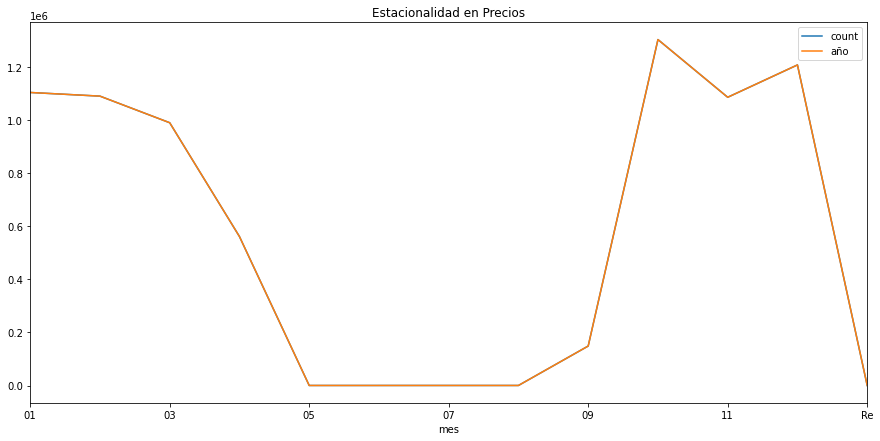

In [38]:
fig, ax = plt.subplots(figsize=(15,7))
temp1.groupby(['mes']).count().plot(ax=ax)
plt.title("Estacionalidad en Precios")
plt.show()

    d. ¿Cuál es el estado más caro y en qué mes?

In [39]:
redu2 = pysparkDF["fechaRegistro","estado","precio"]

In [40]:
pdf = redu2.toPandas()

Py4JJavaError: An error occurred while calling o92.collectToPython.
: java.lang.OutOfMemoryError: Java heap space
	at org.apache.spark.sql.execution.SparkPlan$$anon$1.next(SparkPlan.scala:370)
	at org.apache.spark.sql.execution.SparkPlan$$anon$1.next(SparkPlan.scala:364)
	at scala.collection.Iterator.foreach(Iterator.scala:941)
	at scala.collection.Iterator.foreach$(Iterator.scala:941)
	at org.apache.spark.sql.execution.SparkPlan$$anon$1.foreach(SparkPlan.scala:364)
	at org.apache.spark.sql.execution.SparkPlan.$anonfun$executeCollect$1(SparkPlan.scala:386)
	at org.apache.spark.sql.execution.SparkPlan.$anonfun$executeCollect$1$adapted(SparkPlan.scala:385)
	at org.apache.spark.sql.execution.SparkPlan$$Lambda$2734/459898.apply(Unknown Source)
	at scala.collection.IndexedSeqOptimized.foreach(IndexedSeqOptimized.scala:36)
	at scala.collection.IndexedSeqOptimized.foreach$(IndexedSeqOptimized.scala:33)
	at scala.collection.mutable.ArrayOps$ofRef.foreach(ArrayOps.scala:198)
	at org.apache.spark.sql.execution.SparkPlan.executeCollect(SparkPlan.scala:385)
	at org.apache.spark.sql.Dataset.$anonfun$collectToPython$1(Dataset.scala:3450)
	at org.apache.spark.sql.Dataset$$Lambda$2991/2134003.apply(Unknown Source)
	at org.apache.spark.sql.Dataset.$anonfun$withAction$1(Dataset.scala:3618)
	at org.apache.spark.sql.Dataset$$Lambda$1321/2041412.apply(Unknown Source)
	at org.apache.spark.sql.execution.SQLExecution$.$anonfun$withNewExecutionId$5(SQLExecution.scala:100)
	at org.apache.spark.sql.execution.SQLExecution$$$Lambda$1329/26939382.apply(Unknown Source)
	at org.apache.spark.sql.execution.SQLExecution$.withSQLConfPropagated(SQLExecution.scala:160)
	at org.apache.spark.sql.execution.SQLExecution$.$anonfun$withNewExecutionId$1(SQLExecution.scala:87)
	at org.apache.spark.sql.execution.SQLExecution$$$Lambda$1322/18317404.apply(Unknown Source)
	at org.apache.spark.sql.SparkSession.withActive(SparkSession.scala:764)
	at org.apache.spark.sql.execution.SQLExecution$.withNewExecutionId(SQLExecution.scala:64)
	at org.apache.spark.sql.Dataset.withAction(Dataset.scala:3616)
	at org.apache.spark.sql.Dataset.collectToPython(Dataset.scala:3447)
	at sun.reflect.NativeMethodAccessorImpl.invoke0(Native Method)
	at sun.reflect.NativeMethodAccessorImpl.invoke(Unknown Source)
	at sun.reflect.DelegatingMethodAccessorImpl.invoke(Unknown Source)
	at java.lang.reflect.Method.invoke(Unknown Source)
	at py4j.reflection.MethodInvoker.invoke(MethodInvoker.java:244)
	at py4j.reflection.ReflectionEngine.invoke(ReflectionEngine.java:357)
	at py4j.Gateway.invoke(Gateway.java:282)


In [42]:
temp2 = pd.DataFrame(redu2,columns=["fechaRegistro","estado","precio"])
temp2["año"]=temp1.fechaRegistro.apply(lambda x: x[:4])
temp2["mes"]=temp1.fechaRegistro.apply(lambda x: x[5:7])
temp2 = temp2.drop("fechaRegistro",axis=1)
temp2

    e. ¿Cuáles son los principales riesgos de hacer análisis de series de tiempo con estos datos?

In [43]:
# previo al uso extensivo de tecnología, el cual aún se encuentra en adopción, los registros se llevaban
# de forma manual, por lo cual sería frecuente encontrar discrepancias entre los datos según se retroceda en el tiempo.

#### 3. Visualización
    a. Genera un mapa que nos permita identificar la oferta de categorías en la zona metropolitana de León Guanajuato y el nivel de precios en cada una de ellas. Se darán puntos extra si el mapa es interactivo.

In [44]:
# primero se filtran los datos para el área metropolitana de León, Gto.
edo_gto = pysparkDF[pysparkDF["estado"] == "GUANAJUATO"]
mun_leon = pysparkDF[(pysparkDF["municipio"] == "LEON")|(pysparkDF["municipio"] == "LEÓN")]
print("Hay {:,} registros en León, Gto.".format(mun_leon.count()))

Hay 729,987 registros en León, Gto.


In [45]:
# se importa la librería "folium" porque permite desplazarse en el mapa y modificar el acercamiento.
# se hará uso de la librería "random" ya que no es factible cargar tantos marcadores en el mapa
import folium
from folium.plugins import HeatMap
from random import sample 

In [46]:
# se convierte a DataFrame de pandas para mayor facilidad manipulando las coordenadas
temp3 = mun_leon.select("*").toPandas()

In [47]:
# selección de columnas y limpieza de datos nulos
mun_leon_df = temp3[["categoria","precio","latitud","longitud"]]
mun_leon_df.dropna(axis=0,how="any",inplace=True)
mun_leon_df.dtypes

c:\users\dxoco\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


categoria    object
precio       object
latitud      object
longitud     object
dtype: object

In [48]:
mun_leon_df.isnull().sum()

categoria    0
precio       0
latitud      0
longitud     0
dtype: int64

In [49]:
mun_leon_df.isna().sum()

categoria    0
precio       0
latitud      0
longitud     0
dtype: int64

In [50]:
# se retiran valores "NA" para obtener un dataframe más limpio
try:
    leon_limpio = mun_leon_df[(mun_leon_df["latitud"]!="NA")|(mun_leon_df["longitud"]!="NA")]
    leon_limpio.reset_index(inplace=True)
    leon_limpio.drop("index",axis=1,inplace=True)
except:
    leon_limpio.head(3)
leon_limpio.head(3)

c:\users\dxoco\appdata\local\programs\python\python37\lib\site-packages\pandas\core\frame.py:4117: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,categoria,precio,latitud,longitud
0,TORTILLAS Y DERIVADOS DEL MAIZ,10,21.141389,-101.687397
1,TORTILLAS Y DERIVADOS DEL MAIZ,23,21.141389,-101.687397
2,PAN,1.5,21.141389,-101.687397


In [51]:
# se crea un lista con las variables deseadas para llamarlas en la creación del mapa y los marcadores
listilla = list(zip(leon_limpio.latitud.values,leon_limpio.longitud.values,leon_limpio.categoria,leon_limpio.precio))
# se define un punto donde centrar el mapa
hmap_all = folium.Map(location=[21.1323074,-101.6500494], zoom_start=12, )
hm_wide_all = HeatMap( list(zip(leon_limpio.latitud.values, leon_limpio.longitud.values)),
                   min_opacity=0.15,
                   max_val=1000000,
                   radius=15,
                   blur=15, 
                   max_zoom=1, 
                 )
# se genera una muestra aleatoria para insertar marcadores en el mapa
ale = sample(listilla,800)
for i in range(800):
    folium.Marker([ale[i][0], ale[i][1]],
              popup=f'Producto encontrado:\n{ale[i][2]}\nPrecio promedio:{ale[i][3]}',
             ).add_to(hmap_all)

In [52]:
hmap_all.save('OPI_map.html')
hmap_all.add_child(hm_wide_all)

                                                    Sección C

C.1 BOPS
Resuelve el siguiente caso:

    1. ¿Deberían expandirse a Canadá?

# Si.
## Sería beneficioso para Home & Kitchen expandirse a Canadá.
### Esta conclusión se desarrolla después de resolver el punto 2.
El escenario parece un desastre si solamente comparamos las ventas totales, pues la disminución está entre el 11% para ventas en tienda física y un 16% para ventas por internet. Lo cual se agrega a 30.7 mdd. ¡Alarmante para cualquier directivo!

Sin embargo, los gráficos de línea muestran de manera inmediata que existe una disparidad entre los datos que se están comparando, es decir: la estacionalidad.

Home & Kitchen tiene picos de ventas a lo largo del año:

    • En Mayo, Agosto y Diciembre para la venta en línea.
    • En Mayo y Octubre para las tiendas físicas.

Esto nos indica que nuestros datos previos al BOPS, que corren de Abril a Octubre, están gozando de 4 de los 5 picos de ventas, pues las tiendas físicas realizan la venta fuerte de Octubre en la primer semana de ese mes.

Un factor adicional a considerar, también de estacionalidad, son los valles en las ventas. 

    • Las ventas en línea sufren por los primeros tres meses del año, recuperándose prácticamente con el pico de Mayo.
    • Para las tiendas físicas Febrero y Junio son los dos meses con menor actividad durante el año.
    
Cuando juntamos los factores que ya mencionamos de la estacionalidad, es muy notorio que nuestros datos se están comparando pobremente; ya que se podría obtener una visión más amplia si se comparasen datos históricos de al menos los últimos 5 años.

    2. ¿Cuántos millones de dólares se ganaron o perdieron a partir del programa? Explica tu razonamiento y metodología.
    Pista: Existen dos experimentos naturales. Canadá y las tiendas que se encuentran lejos. Utilízalos.

In [53]:
bm_bops = pd.read_csv('bops_bm.csv')
on_bops = pd.read_csv('bops_online.csv')
bm_bops.drop(['Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9', 'Unnamed: 10'],axis=1,inplace=True)
on_bops.drop(['Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9', 'Unnamed: 10', 'Unnamed: 11',
       'Unnamed: 12', 'Unnamed: 13', 'Unnamed: 14', 'Unnamed: 15',
       'Unnamed: 16'],axis=1,inplace=True)

In [54]:
# se realiza un análisis simple para encontrar cuántos millones de USD se ganaron o perdieron.
# después se comienza con la limpieza de los dataframes
bm_bops.columns

Index(['id (store)', 'year', 'month', 'week', 'usa', 'after', ' sales '], dtype='object')

In [55]:
# la columna "sales" en ambos dataframes tiene caracteres que no sirven, como espacios y comas
# primero se genera una columna nueva con el nombre sin espacios
bm_bops["sales"] = bm_bops[" sales "]
on_bops["sales"] = on_bops[" sales "]
# después se elimina la columna original
bm_bops.drop(" sales ",axis=1,inplace=True)
on_bops.drop(" sales ",axis=1,inplace=True)

In [56]:
# se hace uso de expresiones regulares para limpiar la columna "sales" en ambos dataframes
# cualquier cosa que no sea un número se va a retirar de la información
# y con "strip" se retira cualquier espacio que pudiera haber permanecido
for s in range(len(on_bops)):
    try:
        on_bops.sales[s] = re.sub('[^0-9]', '', on_bops.sales[s]).strip()
    except:
        pass
    
for s in range(len(bm_bops)):
    try:
        bm_bops.sales[s] = re.sub('[^0-9]', '', bm_bops.sales[s]).strip()
    except:
        pass

c:\users\dxoco\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
c:\users\dxoco\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


In [57]:
# se elimina cualquier fila que tenga no tenga valor
bm_bops.dropna(how="any",inplace=True)
on_bops.dropna(how="any",inplace=True)
# se declaran ambos dataframes con tipo de valor "integer"
on_bops = on_bops.astype("int64")
bm_bops = bm_bops.astype("int64")

In [58]:
print("semanas del año en octubre de 2011: ",on_bops[on_bops.month==10]["week"].unique())
# con el cálculo de las semanas se dividen los dataframes en dos partes: previo y posterior a BOPS
on_half_1 = on_bops[(on_bops.week<43)&(on_bops.year==2011)]
on_half_2 = on_bops[(on_bops.week>42)|(on_bops.year==2012)]
bm_half_1 = bm_bops[(bm_bops.week<43)&(bm_bops.year==2011)]
bm_half_2 = bm_bops[(bm_bops.week>42)|(bm_bops.year==2012)]

semanas del año en octubre de 2011:  [41 42 43 44 45]


In [59]:
print("""Ventas online previas a BOPS fueron de {:,}
Ventas online posteriores a BOPS fueron de {:,}""".format(on_half_1.sales.sum(),on_half_2.sales.sum()))

Ventas online previas a BOPS fueron de 80,468,614
Ventas online posteriores a BOPS fueron de 66,854,985


In [60]:
print("""Ventas en tienda física previas a BOPS fueron de {:,}
Ventas en tienda física posteriores a BOPS fueron de {:,}""".format(bm_half_1.sales.sum(),bm_half_2.sales.sum()))

Ventas en tienda física previas a BOPS fueron de 153,420,472
Ventas en tienda física posteriores a BOPS fueron de 136,308,894


Hasta este punto, la cantidad tota de ventas sugeriría que se está teniendo una adopción lenta del BOPS por parte de los clientes, sin embargo, se deben de considerar dos factores adicionales:

        • Falta que Canadá haga lanzamiento de BOPS
        • Las ventas totales que se muestran no reflejan la estacionalidad

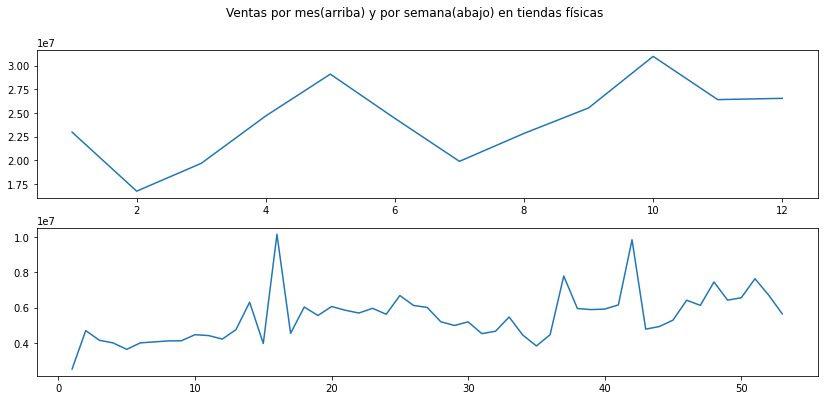

In [61]:
fig, axs = plt.subplots(2,figsize=(14,6))
fig.suptitle('Ventas por mes(arriba) y por semana(abajo) en tiendas físicas')
axs[0].plot(bm_bops.groupby("month").agg({"sales":sum}))
axs[1].plot(bm_bops.groupby("week").agg({"sales":sum}))
plt.show()

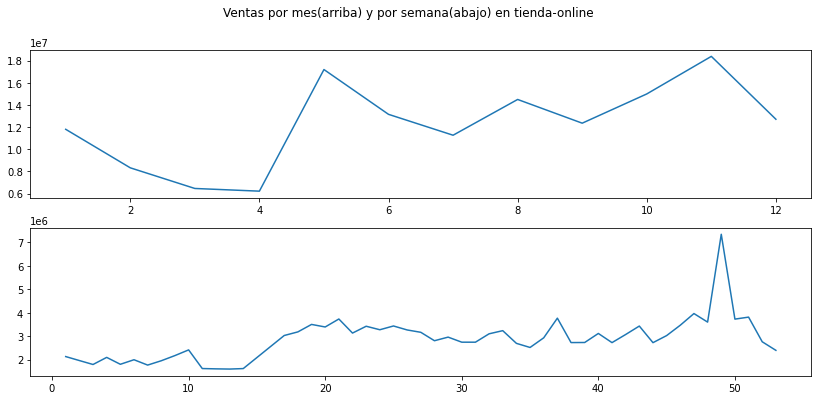

In [62]:
fig, axs = plt.subplots(2,figsize=(14,6))
fig.suptitle('Ventas por mes(arriba) y por semana(abajo) en tienda-online')
axs[0].plot(on_bops.groupby("month").agg({"sales":sum}))
axs[1].plot(on_bops.groupby("week").agg({"sales":sum}))
plt.show()